image classification using keras and tensorflow. convolution neural network.    
(applies filters to input image,generates a sigle output value, repeats. lears features of image)     
RGB

DATA PREPROCESSING

In [41]:
import numpy as np
import cv2
import os
import random
import matplotlib.pyplot as plt 


numpy for array operation      
cv2 for converting images into arrays      
os to get location of images     
random for randomizing     
matplotlib for visualization    


In [42]:
location = r'/Users/raphaelsackey/Desktop/animal dataset'
categories = ['land_animal', 'sea_animal']

reading avery image and converting it into an arry and saving it into a list     

Skipping /Users/raphaelsackey/Desktop/animal dataset/land_animal/.DS_Store as it could not be read
[[array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8), 0], [array([[[148, 135, 137],
        [142, 131, 133],
        [146, 132, 134],
        ...,
     

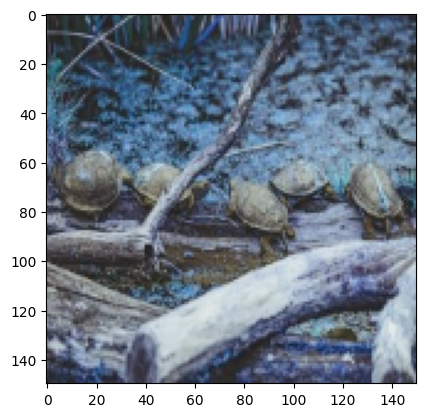

In [43]:
img_size = 150

data = []

for i in categories:
    folder = os.path.join(location, i)
    label = categories.index(i)
    for img in os.listdir(folder):
        img_path = os.path.join(folder, img)
        img_arr = cv2.imread(img_path) #reads image
        #plt.imshow(img_arr)
        if img_arr is not None:
            img_arr = cv2.resize(img_arr, (img_size, img_size))
            data.append([img_arr,label])
        else:
            print(f"Skipping {img_path} as it could not be read")
    plt.imshow(img_arr)
    print (data)
    

In [44]:
len(data)

1975

shuffle data so model trains equally 

In [45]:
random.shuffle(data)

In [46]:
x = []
y = []

for features, label in data:
    x.append(features)
    y.append(label)

convert the data into numpy arrays to be used for training

In [47]:
x = np.array(x)
y = np.array(y)

Training

In [48]:
len(x)

1975

In [49]:
x = x/255

In [50]:
print(x)

[[[[0.8627451  0.82352941 0.84705882]
   [0.83921569 0.8        0.82352941]
   [0.87058824 0.84313725 0.8627451 ]
   ...
   [0.75294118 0.74901961 0.76470588]
   [0.76470588 0.76078431 0.77647059]
   [0.78039216 0.77647059 0.79215686]]

  [[0.83921569 0.81176471 0.83137255]
   [0.83529412 0.80392157 0.82352941]
   [0.85490196 0.82745098 0.84705882]
   ...
   [0.78431373 0.77647059 0.79607843]
   [0.76470588 0.76078431 0.78039216]
   [0.75686275 0.74901961 0.77254902]]

  [[0.82352941 0.8        0.81960784]
   [0.82352941 0.79607843 0.81568627]
   [0.84313725 0.81568627 0.83529412]
   ...
   [0.79607843 0.78823529 0.81568627]
   [0.75294118 0.74509804 0.77254902]
   [0.74117647 0.7372549  0.76078431]]

  ...

  [[0.79607843 0.80784314 0.82745098]
   [0.78431373 0.78823529 0.80392157]
   [0.74117647 0.73333333 0.75686275]
   ...
   [0.41960784 0.32156863 0.31372549]
   [0.41176471 0.29411765 0.2745098 ]
   [0.41176471 0.29019608 0.2627451 ]]

  [[0.82352941 0.83529412 0.85490196]
   [0.7

In [32]:
x.shape

(1975, 150, 150, 3)

In [33]:
from keras.models import Sequential 
from keras.layers import Conv2D, MaxPooling2D, Flatten,Dense

convolusion process  
imput image * feature detectors = Feature map     
activation function

In [36]:
model = Sequential()

model.add(Conv2D(64, (3,3), activation = 'relu'))
model.add(MaxPooling2D((2,2)))

model.add(Conv2D(64, (3,3), activation = 'relu'))
model.add(MaxPooling2D((2,2)))

model.add(Conv2D(64, (3,3), activation = 'relu'))
model.add(MaxPooling2D((2,2)))

model.add(Flatten()) #creating one dimentional array 

model.add(Dense(128, input_shape = x.shape[1:], activation = 'relu'))

#model.add(Dense(128,activation = 'relu'))


model.add(Dense(2, activation = 'softmax')) #output

In [37]:
model.compile(optimizer = 'adam', loss = 'sparse_categorical_crossentropy', metrics = ['accuracy'])

Epoch 1/15
56/56 [==============================] - 104s 2s/step - loss: 0.5244 - accuracy: 0.6989 - val_loss: 0.5180 - val_accuracy: 0.6768
Epoch 2/15
56/56 [==============================] - 116s 2s/step - loss: 0.4566 - accuracy: 0.7569 - val_loss: 0.4227 - val_accuracy: 0.7778
Epoch 3/15
56/56 [==============================] - 118s 2s/step - loss: 0.3983 - accuracy: 0.8126 - val_loss: 0.3627 - val_accuracy: 0.8182
Epoch 4/15
56/56 [==============================] - 113s 2s/step - loss: 0.2943 - accuracy: 0.8745 - val_loss: 0.3011 - val_accuracy: 0.8535
Epoch 5/15
56/56 [==============================] - 108s 2s/step - loss: 0.1961 - accuracy: 0.9207 - val_loss: 0.2979 - val_accuracy: 0.8687
Epoch 6/15
56/56 [==============================] - 92s 2s/step - loss: 0.1866 - accuracy: 0.9252 - val_loss: 0.3393 - val_accuracy: 0.8535
Epoch 7/15
56/56 [==============================] - 97s 2s/step - loss: 0.1237 - accuracy: 0.9527 - val_loss: 0.4083 - val_accuracy: 0.8283
Epoch 8/15
56/5

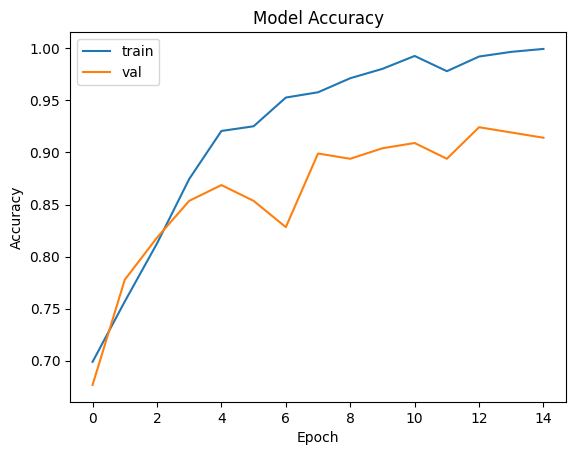

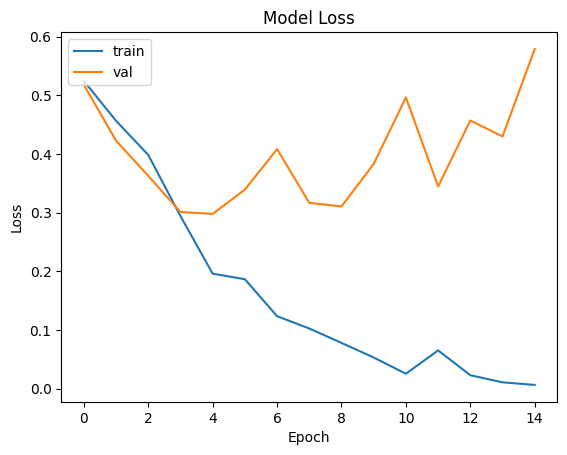

In [38]:
history = model.fit(x, y, epochs = 15, validation_split = 0.1)
# Plot the training and validation accuracy over epochs
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

# Plot the training and validation loss over epochs
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

now lets use chatGPT   


ill ask the question:

I have a folder on my desktop named animal dataset. this folder contains two folders land_animal and sea_animal. these two folders have pictures on land and sea animals respectively. write code that does image processing and to able to train and tell if a picture is a land animal or sea animal 

In [1]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

# Step 1: Load and preprocess the images

# Define the image dimensions
img_width, img_height = 100, 100

# Define the paths to the land_animal and sea_animal folders
land_animal_path = 'animal_dataset/land_animal'
sea_animal_path = 'animal_dataset/sea_animal'

# Initialize empty lists to store the images and their corresponding labels
images = []
labels = []

# Load land animal images
for filename in os.listdir(land_animal_path):
    img = cv2.imread(os.path.join(land_animal_path, filename))
    img = cv2.resize(img, (img_width, img_height))
    images.append(img)
    labels.append(0)  # 0 represents land animals

# Load sea animal images
for filename in os.listdir(sea_animal_path):
    img = cv2.imread(os.path.join(sea_animal_path, filename))
    img = cv2.resize(img, (img_width, img_height))
    images.append(img)
    labels.append(1)  # 1 represents sea animals

# Convert the lists to NumPy arrays
images = np.array(images)
labels = np.array(labels)

# Step 2: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Step 3: Define and train the model
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(img_width, img_height, 3)))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test))

# Step 4: Use the trained model to predict new images

# Load a new image to classify
new_image_path = 'animal_dataset/land_animal/new_land_animal.jpg'
new_image = cv2.imread(new_image_path)
new_image = cv2.resize(new_image, (img_width, img_height))
new_image = np.expand_dims(new_image, axis=0)

# Make predictions
prediction = model.predict(new_image)
if prediction[0][0] < 0.5:
    print("The image is classified as a land animal.")
else:
    print("The image is classified as a sea animal.")


2023-05-17 18:11:23.038434: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


FileNotFoundError: [Errno 2] No such file or directory: 'animal_dataset/land_animal'

chat GPT didnt know my file path which is fair so i had to give it the right file path

In [2]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

# Step 1: Load and preprocess the images

# Define the image dimensions
img_width, img_height = 100, 100

# Define the paths to the land_animal and sea_animal folders
land_animal_path = '/Users/raphaelsackey/Desktop/animal dataset/land_animal'
sea_animal_path = '/Users/raphaelsackey/Desktop/animal dataset/sea_animal'

# Initialize empty lists to store the images and their corresponding labels
images = []
labels = []

# Load land animal images
for filename in os.listdir(land_animal_path):
    img = cv2.imread(os.path.join(land_animal_path, filename))
    img = cv2.resize(img, (img_width, img_height))
    images.append(img)
    labels.append(0)  # 0 represents land animals

# Load sea animal images
for filename in os.listdir(sea_animal_path):
    img = cv2.imread(os.path.join(sea_animal_path, filename))
    img = cv2.resize(img, (img_width, img_height))
    images.append(img)
    labels.append(1)  # 1 represents sea animals

# Convert the lists to NumPy arrays
images = np.array(images)
labels = np.array(labels)

# Step 2: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Step 3: Define and train the model
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(img_width, img_height, 3)))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test))

# Step 4: Use the trained model to predict new images

# Load a new image to classify
new_image_path = 'animal_dataset/land_animal/new_land_animal.jpg'
new_image = cv2.imread(new_image_path)
new_image = cv2.resize(new_image, (img_width, img_height))
new_image = np.expand_dims(new_image, axis=0)

# Make predictions
prediction = model.predict(new_image)
if prediction[0][0] < 0.5:
    print("The image is classified as a land animal.")
else:
    print("The image is classified as a sea animal.")


error: OpenCV(4.7.0) /Users/runner/work/opencv-python/opencv-python/opencv/modules/imgproc/src/resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'resize'


im getting this error please fix. error                                     Traceback (most recent call last)
Cell In[2], line 24
     22 for filename in os.listdir(land_animal_path):
     23     img = cv2.imread(os.path.join(land_animal_path, filename))
---> 24     img = cv2.resize(img, (img_width, img_height))
     25     images.append(img)
     26     labels.append(0)  # 0 represents land animals

error: OpenCV(4.7.0) /Users/runner/work/opencv-python/opencv-python/opencv/modules/imgproc/src/resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'resize'

In [22]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

# Step 1: Load and preprocess the images

# Define the image dimensions
img_width, img_height = 150, 150

# Define the paths to the land_animal and sea_animal folders
land_animal_path = '/Users/raphaelsackey/Desktop/animal dataset/land_animal'
sea_animal_path = '/Users/raphaelsackey/Desktop/animal dataset/sea_animal'

# Initialize empty lists to store the images and their corresponding labels
images = []
labels = []

# Load land animal images
for filename in os.listdir(land_animal_path):
    try:
        img = cv2.imread(os.path.join(land_animal_path, filename))
        img = cv2.resize(img, (img_width, img_height))
        if img is not None:
            images.append(img)
            labels.append(0)  # 0 represents land animals
        else:
            print(f"Unable to read or resize image: {filename}")
    except Exception as e:
        print(f"Error processing image: {filename}\n{str(e)}")

# Load sea animal images
for filename in os.listdir(sea_animal_path):
    try:
        img = cv2.imread(os.path.join(sea_animal_path, filename))
        img = cv2.resize(img, (img_width, img_height))
        if img is not None:
            images.append(img)
            labels.append(1)  # 1 represents sea animals
        else:
            print(f"Unable to read or resize image: {filename}")
    except Exception as e:
        print(f"Error processing image: {filename}\n{str(e)}")

# Convert the lists to NumPy arrays
images = np.array(images)
labels = np.array(labels)

# Step 2: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Step 3: Define and train the model
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(img_width, img_height, 3)))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test))

model.save('/Users/raphaelsackey/Desktop/animal dataset/model.h5')


# Step 4: Use the trained model to predict new images

# Load a new image to classify
new_image_path = '/Users/raphaelsackey/Desktop/animal dataset/new_land_animal.jpg'
new_image = cv2.imread(new_image_path)
if new_image is not None:
    new_image = cv2.resize(new_image, (img_width, img_height))
    new_image = np.expand_dims(new_image, axis=0)

    # Make predictions
    prediction = model.predict(new_image)
    if prediction[0][0] < 0.5:
        print("The image is classified as a land animal.")
    else:
        print("The image is classified as a sea animal.")


Error processing image: .DS_Store
OpenCV(4.7.0) /Users/runner/work/opencv-python/opencv-python/opencv/modules/imgproc/src/resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'resize'

Error processing image: .DS_Store
OpenCV(4.7.0) /Users/runner/work/opencv-python/opencv-python/opencv/modules/imgproc/src/resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'resize'

Epoch 1/10
50/50 [==============================] - 63s 1s/step - loss: 19.5335 - accuracy: 0.6728 - val_loss: 0.6084 - val_accuracy: 0.6861
Epoch 2/10
50/50 [==============================] - 57s 1s/step - loss: 0.4992 - accuracy: 0.7449 - val_loss: 0.5010 - val_accuracy: 0.7873
Epoch 3/10
50/50 [==============================] - 52s 1s/step - loss: 0.3988 - accuracy: 0.8063 - val_loss: 0.4483 - val_accuracy: 0.8076
Epoch 4/10
50/50 [==============================] - 50s 993ms/step - loss: 0.3360 - accuracy: 0.8462 - val_loss: 0.4886 - val_accuracy: 0.7899
Epoch 5/10
50/50 [====

1/1 [==============================] - 0s 21ms/step


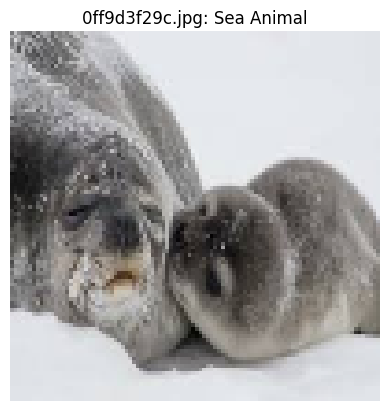

1/1 [==============================] - 0s 19ms/step


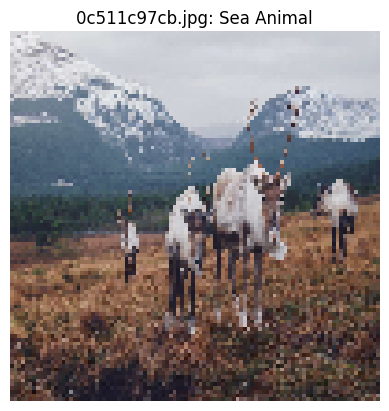

1/1 [==============================] - 0s 33ms/step


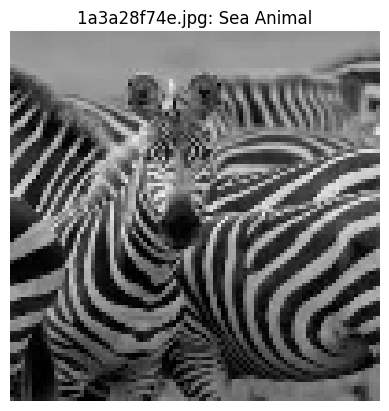

1/1 [==============================] - 0s 26ms/step


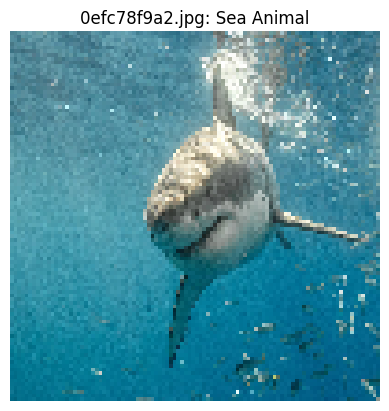

1/1 [==============================] - 0s 40ms/step


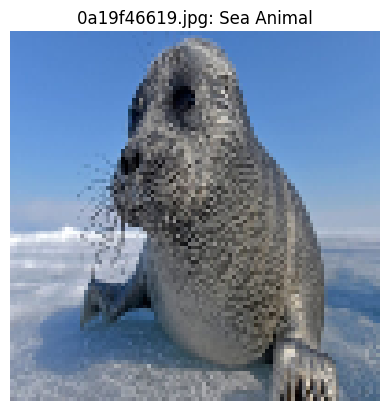

1/1 [==============================] - 0s 62ms/step


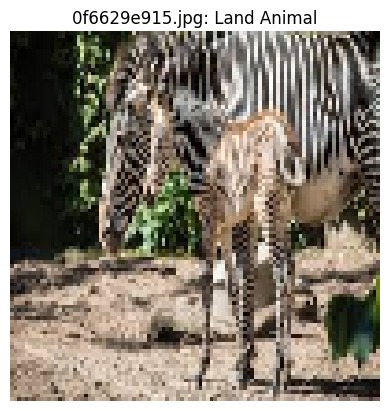

1/1 [==============================] - 0s 41ms/step


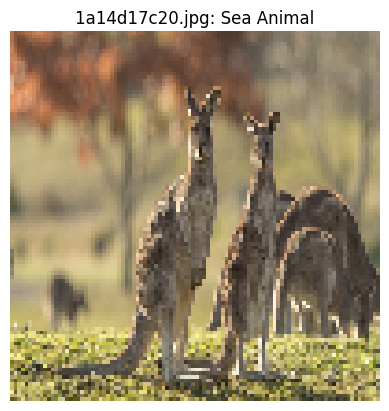

1/1 [==============================] - 0s 31ms/step


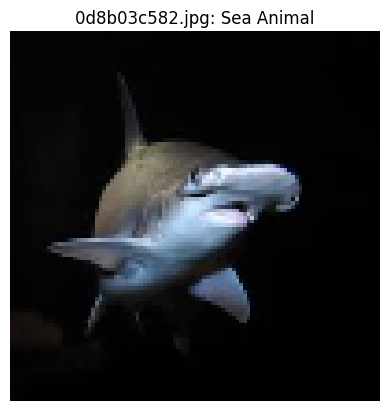

1/1 [==============================] - 0s 25ms/step


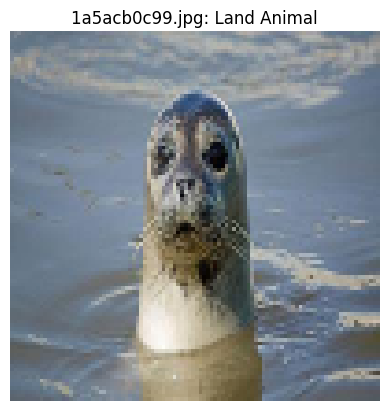

1/1 [==============================] - 0s 23ms/step


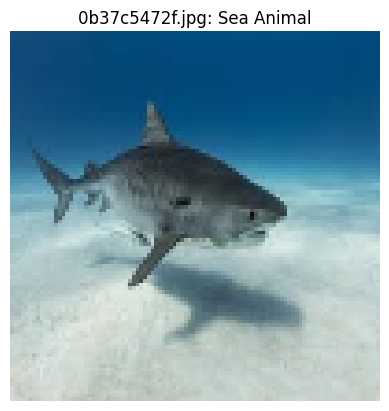

1/1 [==============================] - 0s 21ms/step


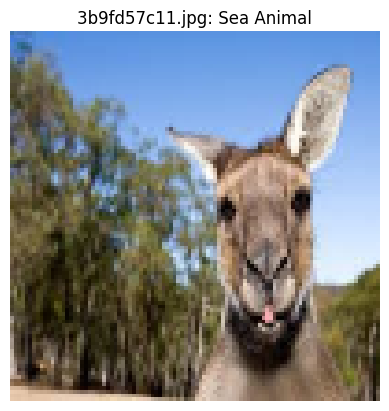

1/1 [==============================] - 0s 23ms/step


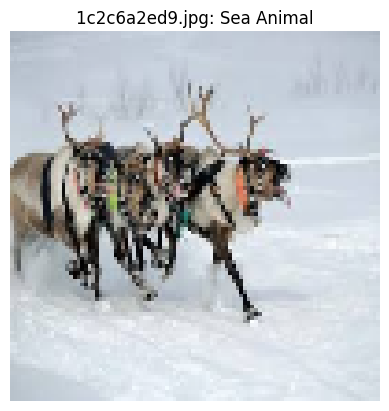

1/1 [==============================] - 0s 23ms/step


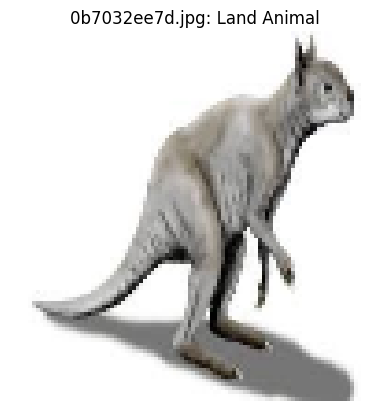

1/1 [==============================] - 0s 24ms/step


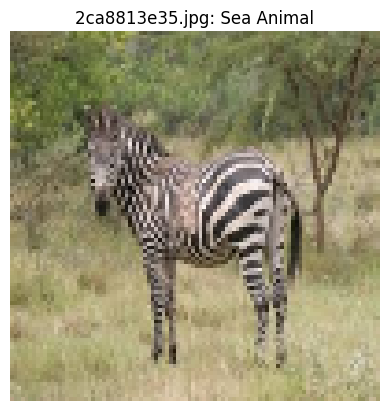

1/1 [==============================] - 0s 23ms/step


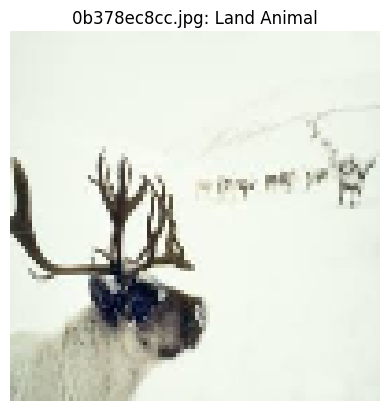

1/1 [==============================] - 0s 23ms/step


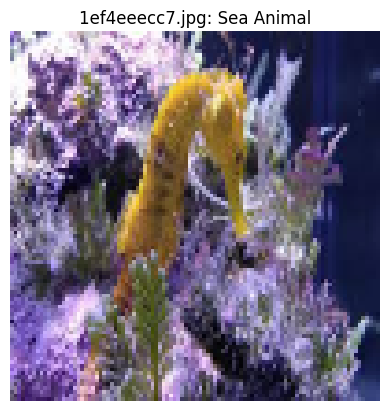

1/1 [==============================] - 0s 22ms/step


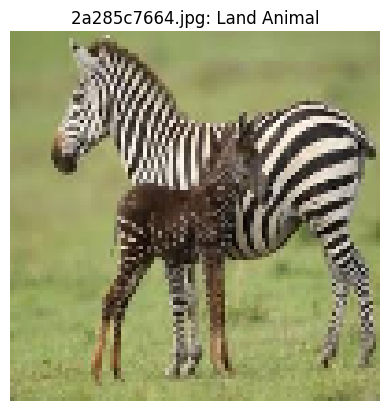

1/1 [==============================] - 0s 26ms/step


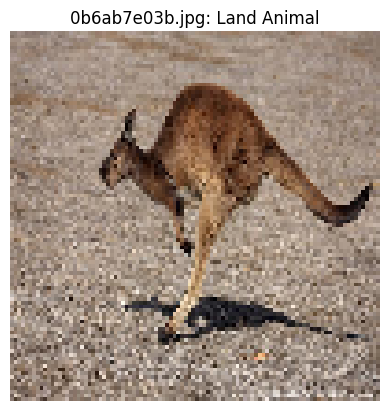

1/1 [==============================] - 0s 21ms/step


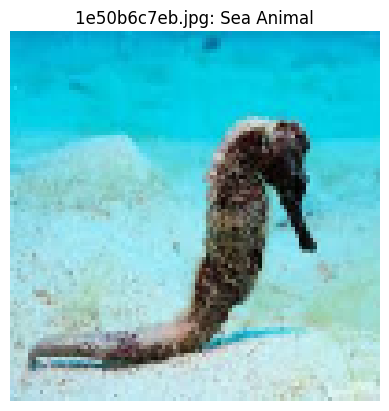

1/1 [==============================] - 0s 26ms/step


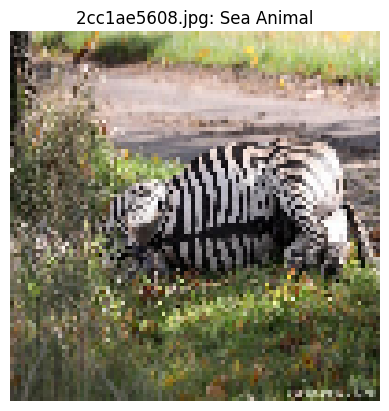

1/1 [==============================] - 0s 21ms/step


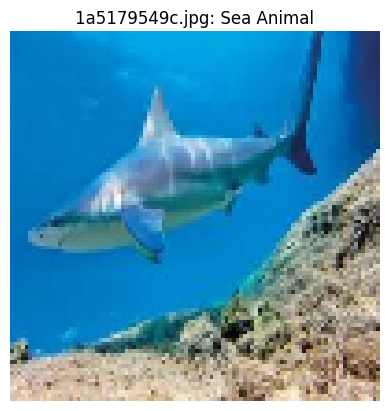

1/1 [==============================] - 0s 22ms/step


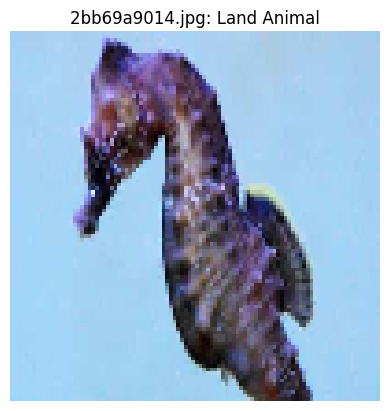

1/1 [==============================] - 0s 24ms/step


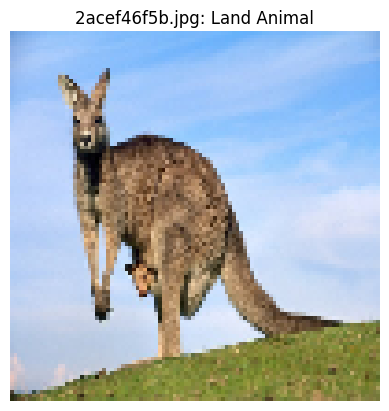

1/1 [==============================] - 0s 24ms/step


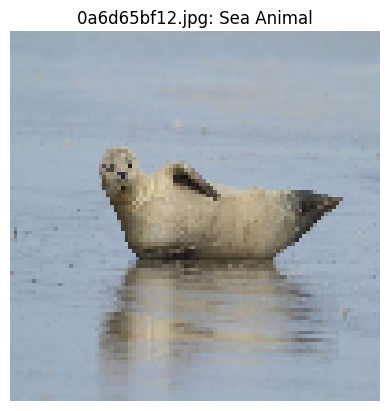

1/1 [==============================] - 0s 23ms/step


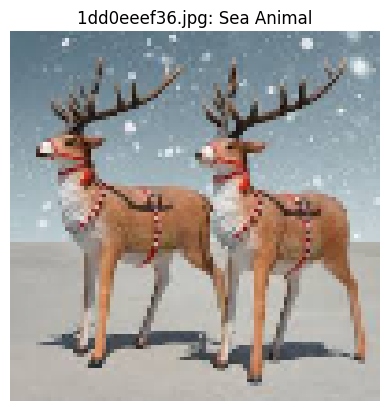

1/1 [==============================] - 0s 24ms/step


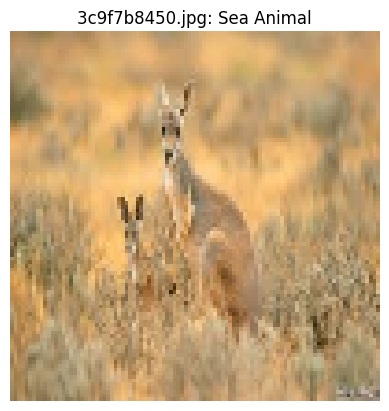

1/1 [==============================] - 0s 54ms/step


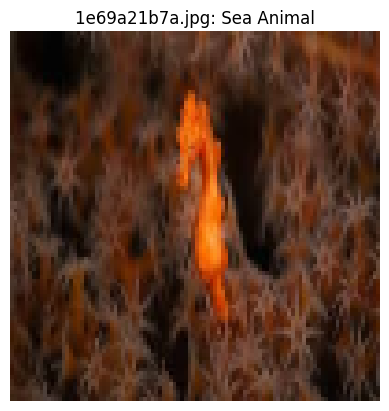

1/1 [==============================] - 0s 107ms/step


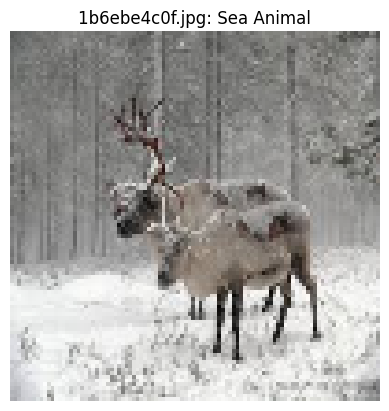

1/1 [==============================] - 0s 34ms/step


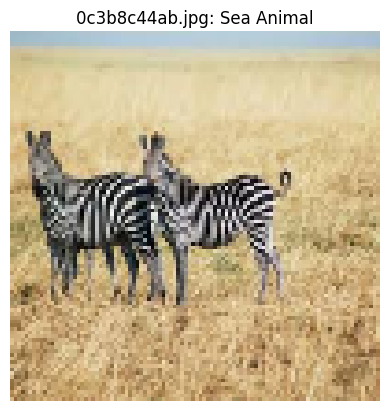

In [9]:
new_land_animal_path = '/Users/raphaelsackey/Desktop/animal dataset/new_land_animal'

# Iterate through the images in the folder
for filename in os.listdir(new_land_animal_path):
    image_path = os.path.join(new_land_animal_path, filename)
    image = cv2.imread(image_path)
    if image is not None:
        image = cv2.resize(image, (img_width, img_height))
        image = np.expand_dims(image, axis=0)

        # Make predictions
        prediction = model.predict(image)
        if prediction[0][0] < 0.5:
            classification = 'Land Animal'
        else:
            classification = 'Sea Animal'

        # Display the image and its classification
        plt.imshow(cv2.cvtColor(image.squeeze(), cv2.COLOR_BGR2RGB))
        plt.title(f'{filename}: {classification}')
        plt.axis('off')
        plt.show()
    else:
        print(f"Unable to read or resize image: {filename}")

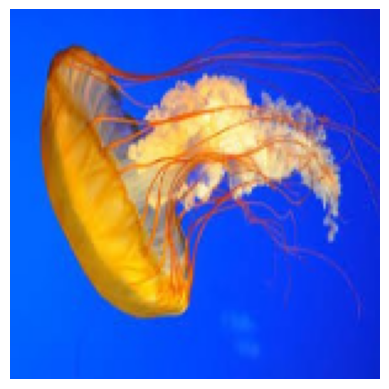

1/1 [==============================] - 0s 137ms/step
The image is classified as a land animal.


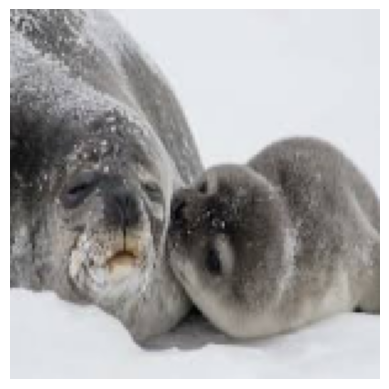

1/1 [==============================] - 0s 39ms/step
The image is classified as a land animal.


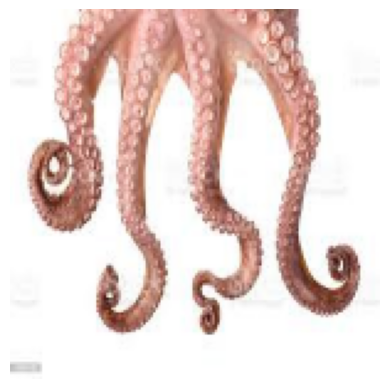

1/1 [==============================] - 0s 48ms/step
The image is classified as a land animal.


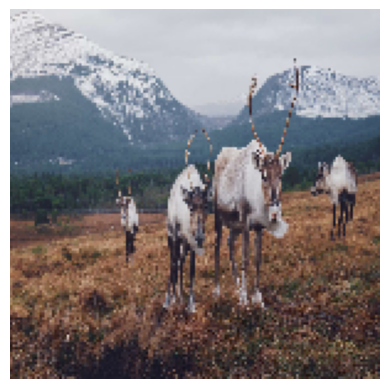

1/1 [==============================] - 0s 43ms/step
The image is classified as a land animal.


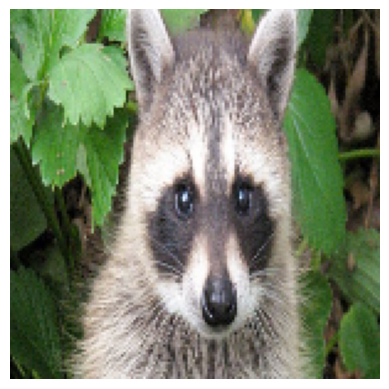

1/1 [==============================] - 0s 79ms/step
The image is classified as a land animal.


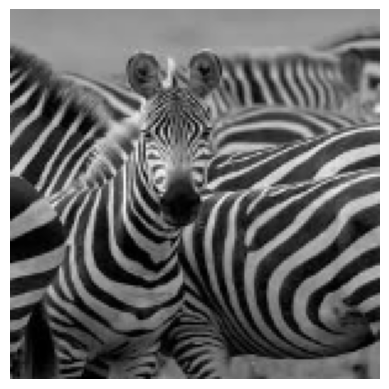

1/1 [==============================] - 0s 39ms/step
The image is classified as a land animal.


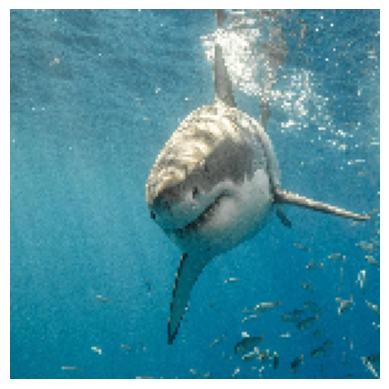

1/1 [==============================] - 0s 44ms/step
The image is classified as a land animal.


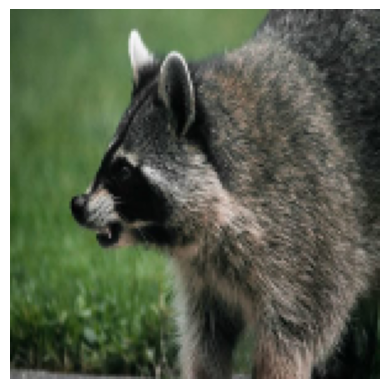

1/1 [==============================] - 0s 31ms/step
The image is classified as a land animal.
Error processing image: .DS_Store
OpenCV(4.7.0) /Users/runner/work/opencv-python/opencv-python/opencv/modules/imgproc/src/resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'resize'



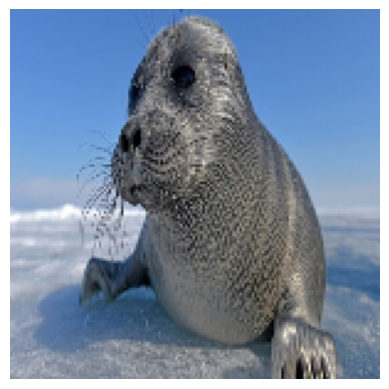

1/1 [==============================] - 0s 37ms/step
The image is classified as a land animal.


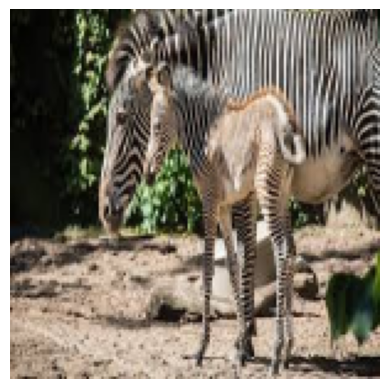

1/1 [==============================] - 0s 53ms/step
The image is classified as a land animal.


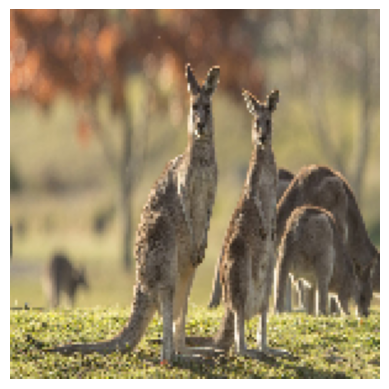

1/1 [==============================] - 0s 59ms/step
The image is classified as a land animal.


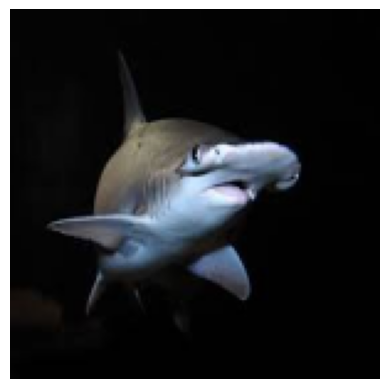

1/1 [==============================] - 0s 37ms/step
The image is classified as a land animal.


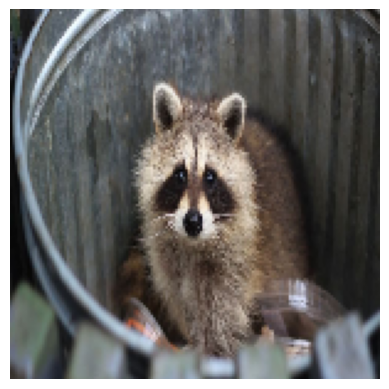

1/1 [==============================] - 0s 31ms/step
The image is classified as a land animal.


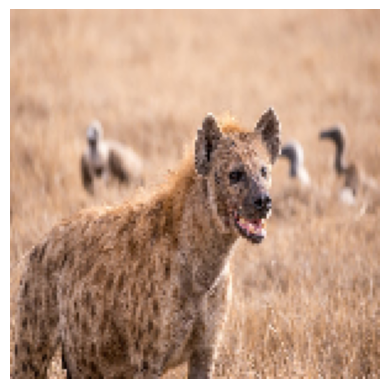

1/1 [==============================] - 0s 51ms/step
The image is classified as a land animal.


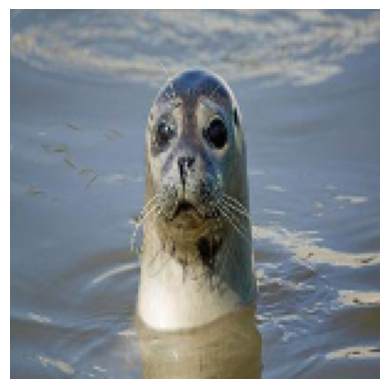

1/1 [==============================] - 0s 36ms/step
The image is classified as a land animal.


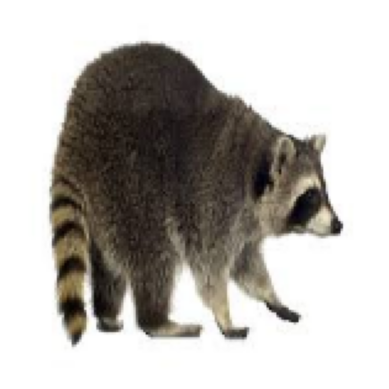

1/1 [==============================] - 0s 38ms/step
The image is classified as a land animal.


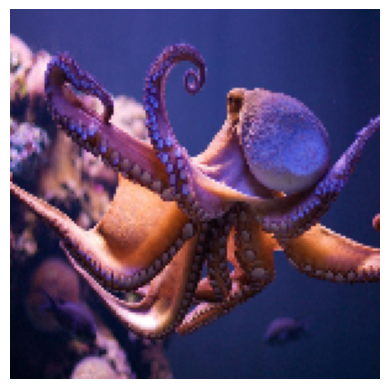

1/1 [==============================] - 0s 40ms/step
The image is classified as a land animal.


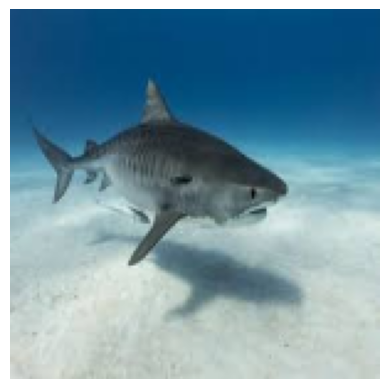

1/1 [==============================] - 0s 54ms/step
The image is classified as a land animal.


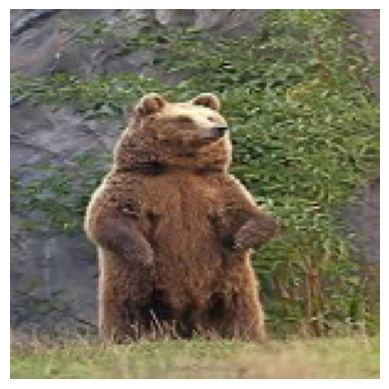

1/1 [==============================] - 0s 45ms/step
The image is classified as a land animal.


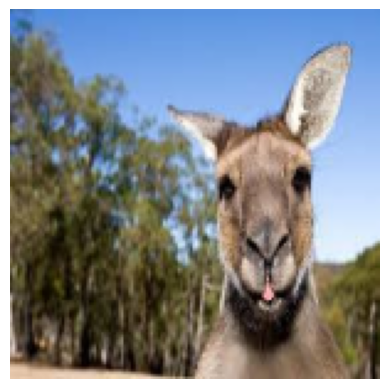

1/1 [==============================] - 0s 58ms/step
The image is classified as a land animal.


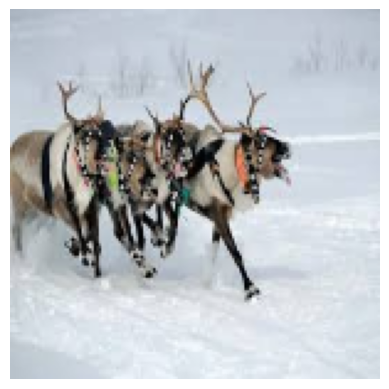

1/1 [==============================] - 0s 62ms/step
The image is classified as a land animal.


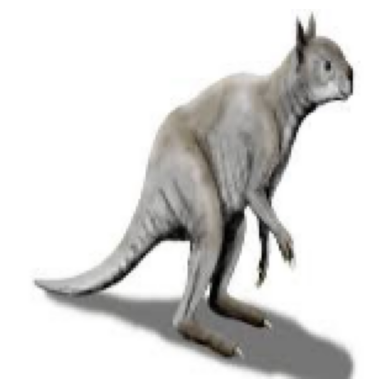

1/1 [==============================] - 0s 75ms/step
The image is classified as a land animal.


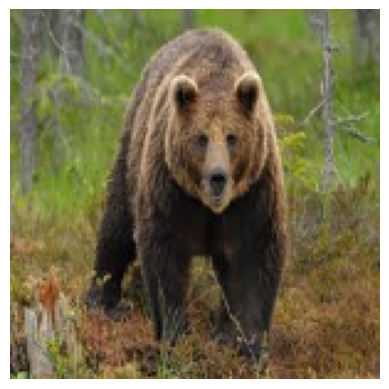

1/1 [==============================] - 0s 54ms/step
The image is classified as a land animal.


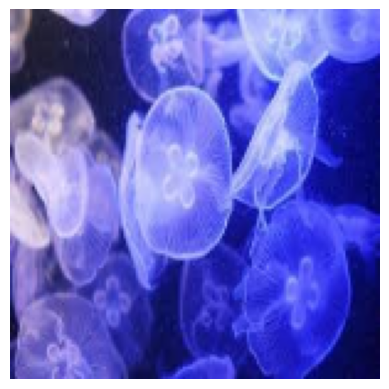

1/1 [==============================] - 0s 53ms/step
The image is classified as a land animal.


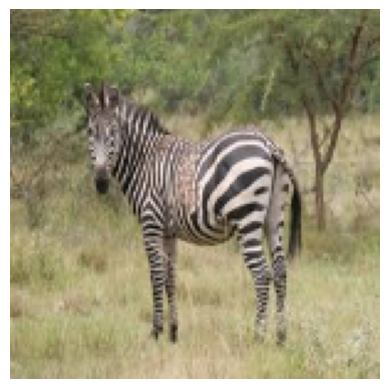

1/1 [==============================] - 0s 79ms/step
The image is classified as a land animal.


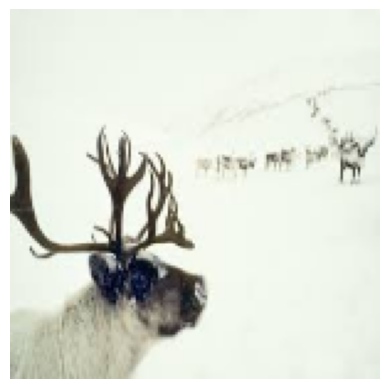

1/1 [==============================] - 0s 49ms/step
The image is classified as a land animal.


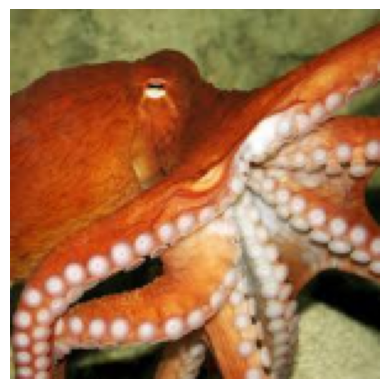

1/1 [==============================] - 0s 47ms/step
The image is classified as a land animal.


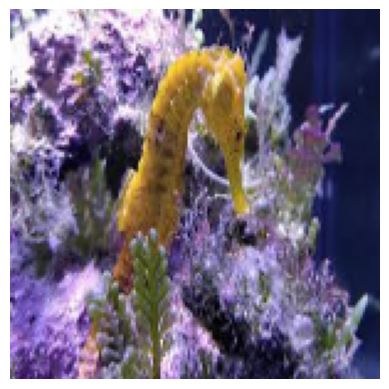

1/1 [==============================] - 0s 42ms/step
The image is classified as a land animal.


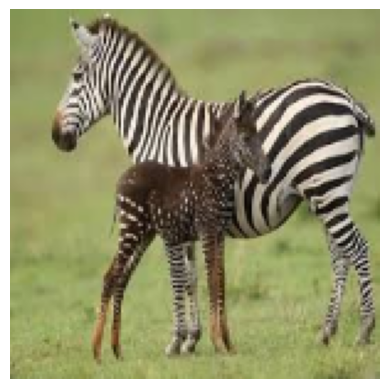

1/1 [==============================] - 0s 33ms/step
The image is classified as a land animal.


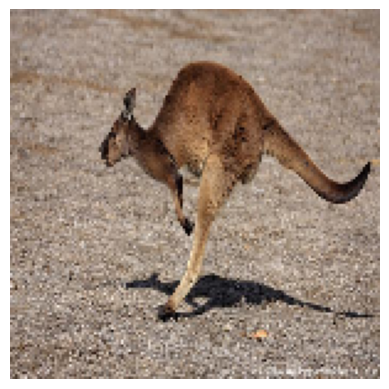

1/1 [==============================] - 0s 48ms/step
The image is classified as a land animal.


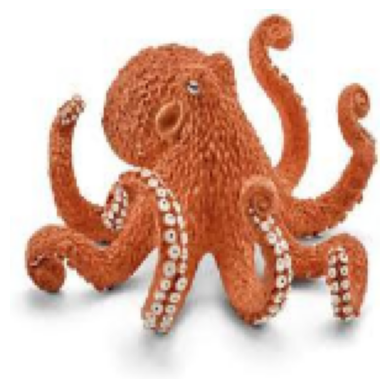

1/1 [==============================] - 0s 37ms/step
The image is classified as a land animal.


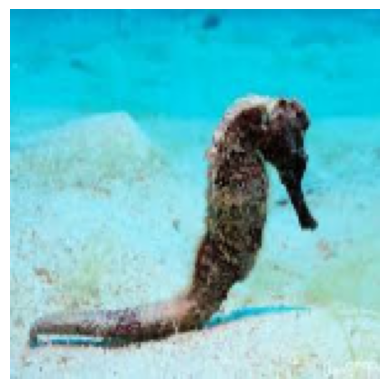

1/1 [==============================] - 0s 43ms/step
The image is classified as a land animal.


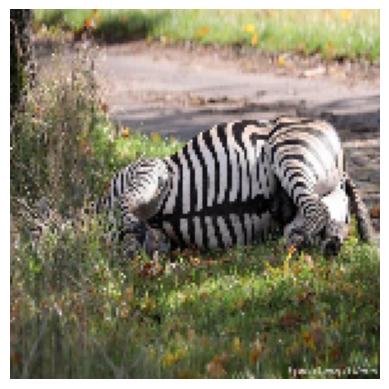

1/1 [==============================] - 0s 46ms/step
The image is classified as a land animal.


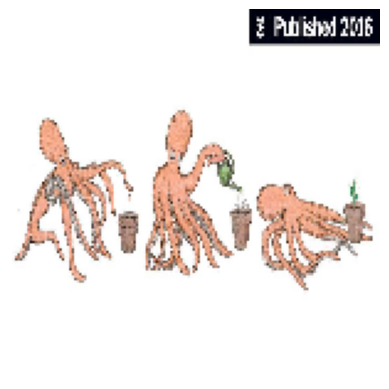

1/1 [==============================] - 0s 43ms/step
The image is classified as a land animal.


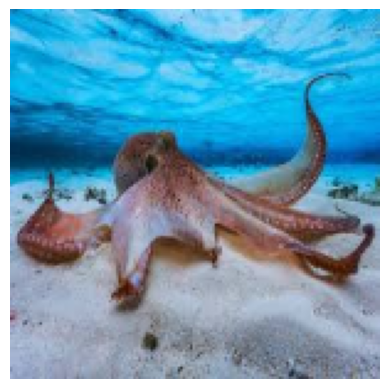

1/1 [==============================] - 0s 34ms/step
The image is classified as a land animal.


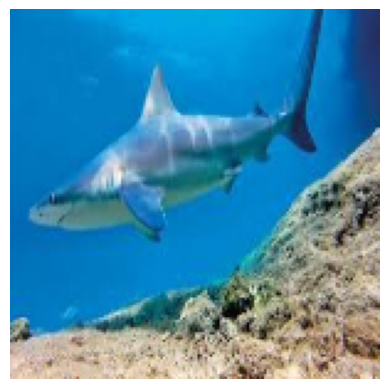

1/1 [==============================] - 0s 50ms/step
The image is classified as a land animal.


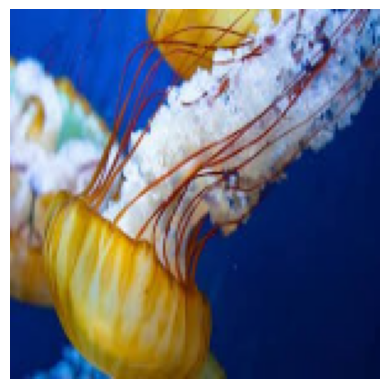

1/1 [==============================] - 0s 44ms/step
The image is classified as a land animal.


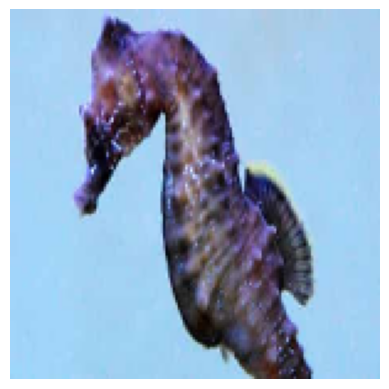

1/1 [==============================] - 0s 47ms/step
The image is classified as a land animal.


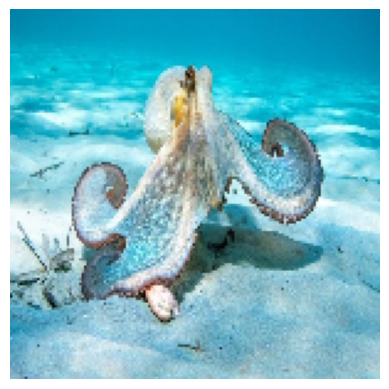

1/1 [==============================] - 0s 46ms/step
The image is classified as a land animal.


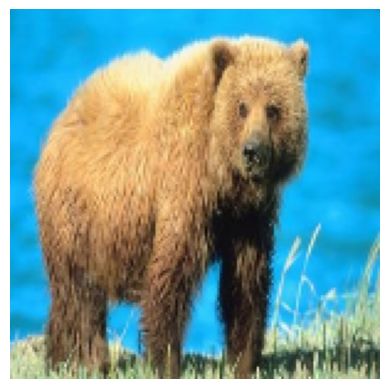

1/1 [==============================] - 0s 44ms/step
The image is classified as a land animal.


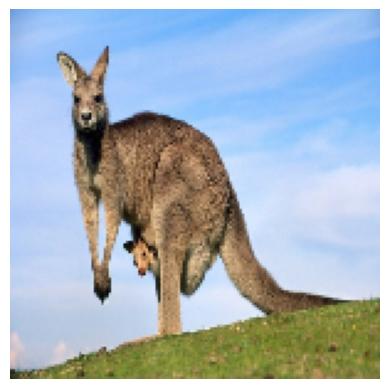

1/1 [==============================] - 0s 46ms/step
The image is classified as a land animal.


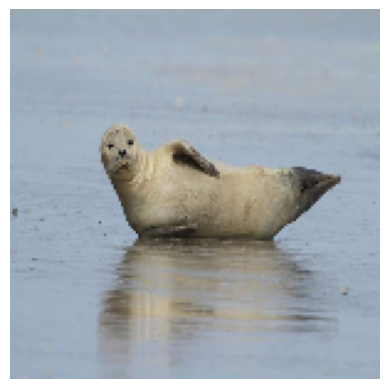

1/1 [==============================] - 0s 51ms/step
The image is classified as a land animal.


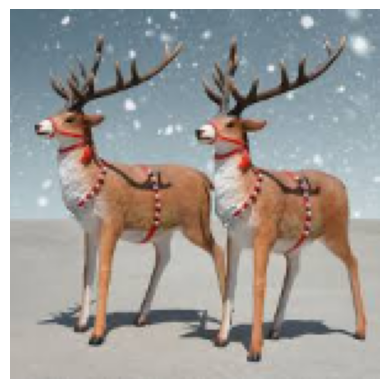

1/1 [==============================] - 0s 50ms/step
The image is classified as a land animal.


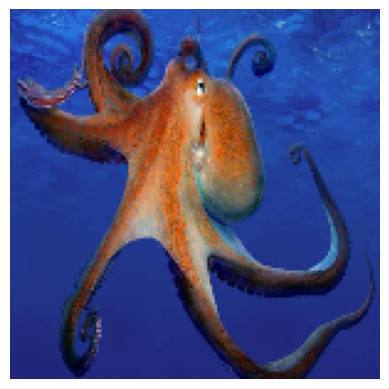

1/1 [==============================] - 0s 50ms/step
The image is classified as a land animal.


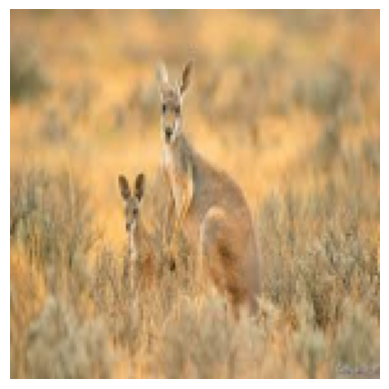

1/1 [==============================] - 0s 46ms/step
The image is classified as a land animal.


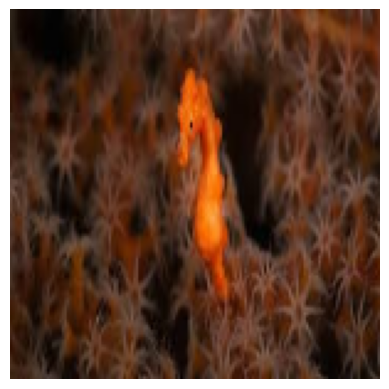

1/1 [==============================] - 0s 47ms/step
The image is classified as a land animal.


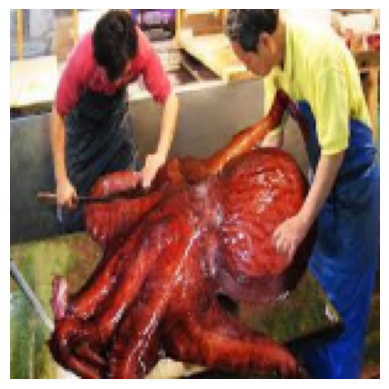

1/1 [==============================] - 0s 43ms/step
The image is classified as a land animal.


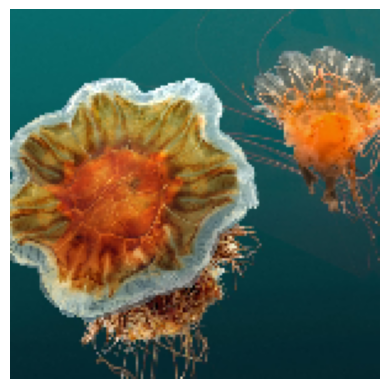

1/1 [==============================] - 0s 47ms/step
The image is classified as a land animal.


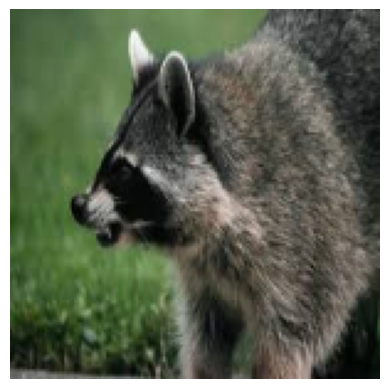

1/1 [==============================] - 0s 48ms/step
The image is classified as a land animal.


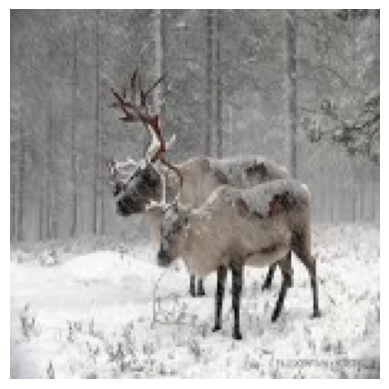

1/1 [==============================] - 0s 44ms/step
The image is classified as a land animal.


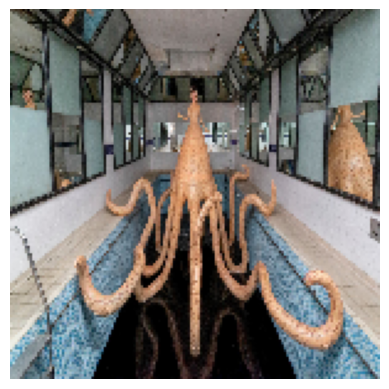

1/1 [==============================] - 0s 46ms/step
The image is classified as a land animal.


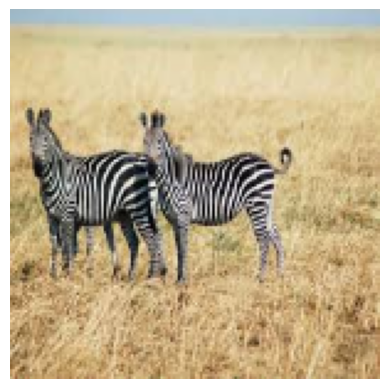

1/1 [==============================] - 0s 43ms/step
The image is classified as a land animal.


In [39]:
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model

# Define the image dimensions
img_width, img_height = 150, 150

# Load the trained model
model = load_model('/Users/raphaelsackey/Desktop/animal dataset/model.h5')

# Define the paths to the new_land_animals folder
new_land_animals_path = '/Users/raphaelsackey/Desktop/animal dataset/new_land_animal'

# Iterate through the images in the new_land_animals folder
for filename in os.listdir(new_land_animals_path):
    try:
        image_path = os.path.join(new_land_animals_path, filename)

        # Load and resize the image
        img = cv2.imread(image_path)
        img = cv2.resize(img, (img_width, img_height))

        # Display the image
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()

        # Preprocess the image for prediction
        img = img / 255.0
        img = np.expand_dims(img, axis=0)

        # Make predictions
        prediction = model.predict(img)
        if prediction[0][0] < 0.5:
            print("The image is classified as a sea animal.")
        else:
            print("The image is classified as a land animal.")
            
    except Exception as e:
        print(f"Error processing image: {filename}\n{str(e)}")


chat gpt code labled all the pictures as land animals. this means the model did not train properly. 
to prove this i will run the dame code using the model that i created from my original code.

In [24]:
import numpy as np
import cv2
import os
import random
import matplotlib.pyplot as plt 

location = r'/Users/raphaelsackey/Desktop/animal dataset'
categories = ['land_animal', 'sea_animal']
img_size = 150

data = []

for i in categories:
    folder = os.path.join(location, i)
    label = categories.index(i)
    for img in os.listdir(folder):
        img_path = os.path.join(folder, img)
        img_arr = cv2.imread(img_path) #reads image
        #plt.imshow(img_arr)
        if img_arr is not None:
            img_arr = cv2.resize(img_arr, (img_size, img_size))
            data.append([img_arr,label])
        else:
            print(f"Skipping {img_path} as it could not be read")
            
random.shuffle(data)
x = []
y = []

for features, label in data:
    x.append(features)
    y.append(label)
x = np.array(x)
y = np.array(y)

x = x/255

from keras.models import Sequential 
from keras.layers import Conv2D, MaxPooling2D, Flatten,Dense

model = Sequential()

model.add(Conv2D(64, (3,3), activation = 'relu'))
model.add(MaxPooling2D((2,2)))

model.add(Conv2D(64, (3,3), activation = 'relu'))
model.add(MaxPooling2D((2,2)))

model.add(Conv2D(64, (3,3), activation = 'relu'))
model.add(MaxPooling2D((2,2)))

model.add(Flatten()) #creating one dimentional array 

model.add(Dense(128, input_shape = x.shape[1:], activation = 'relu'))

#model.add(Dense(128,activation = 'relu'))


model.add(Dense(2, activation = 'softmax')) #output

model.compile(optimizer = 'adam', loss = 'sparse_categorical_crossentropy', metrics = ['accuracy'])

model.fit(x, y, epochs = 15, validation_split = 0.1)

model.save('/Users/raphaelsackey/Desktop/animal dataset/model1.h5')

Skipping /Users/raphaelsackey/Desktop/animal dataset/land_animal/.DS_Store as it could not be read
Skipping /Users/raphaelsackey/Desktop/animal dataset/sea_animal/.DS_Store as it could not be read
Epoch 1/15
56/56 [==============================] - 99s 2s/step - loss: 0.5597 - accuracy: 0.6837 - val_loss: 0.4830 - val_accuracy: 0.7424
Epoch 2/15
56/56 [==============================] - 86s 2s/step - loss: 0.4846 - accuracy: 0.7259 - val_loss: 0.4559 - val_accuracy: 0.7778
Epoch 3/15
56/56 [==============================] - 79s 1s/step - loss: 0.4281 - accuracy: 0.7817 - val_loss: 0.4238 - val_accuracy: 0.7879
Epoch 4/15
56/56 [==============================] - 78s 1s/step - loss: 0.3512 - accuracy: 0.8368 - val_loss: 0.2407 - val_accuracy: 0.9141
Epoch 5/15
56/56 [==============================] - 79s 1s/step - loss: 0.2526 - accuracy: 0.9032 - val_loss: 0.2592 - val_accuracy: 0.8990
Epoch 6/15
56/56 [==============================] - 72s 1s/step - loss: 0.1968 - accuracy: 0.9240 - val

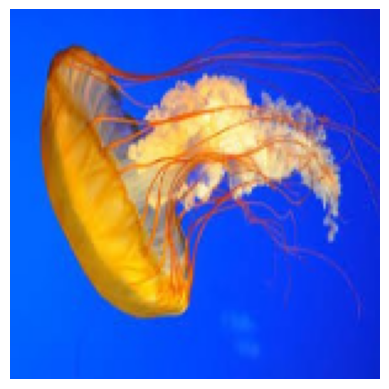

1/1 [==============================] - 0s 110ms/step
The image is classified as a sea animal.


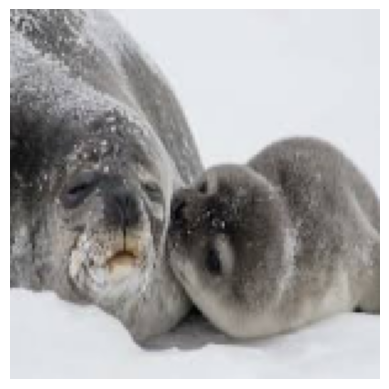

1/1 [==============================] - 0s 79ms/step
The image is classified as a sea animal.


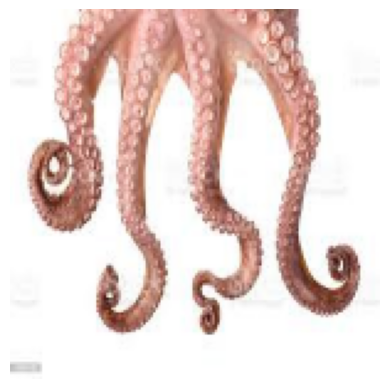

1/1 [==============================] - 0s 51ms/step
The image is classified as a land animal.


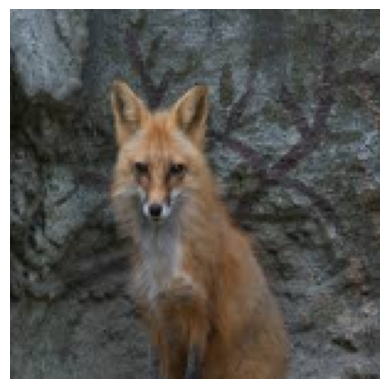

1/1 [==============================] - 0s 57ms/step
The image is classified as a sea animal.


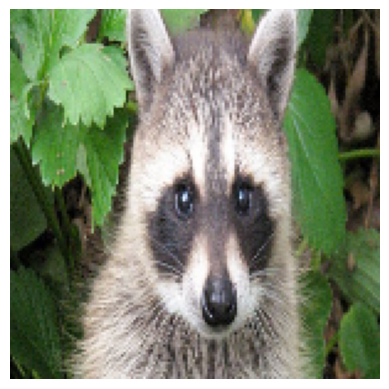

1/1 [==============================] - 0s 47ms/step
The image is classified as a land animal.


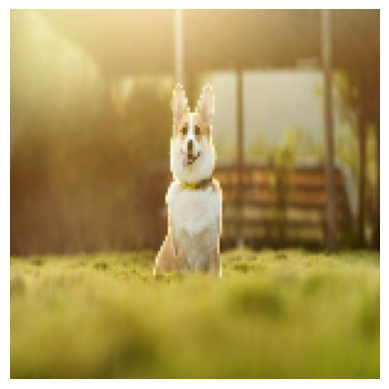

1/1 [==============================] - 0s 48ms/step
The image is classified as a land animal.


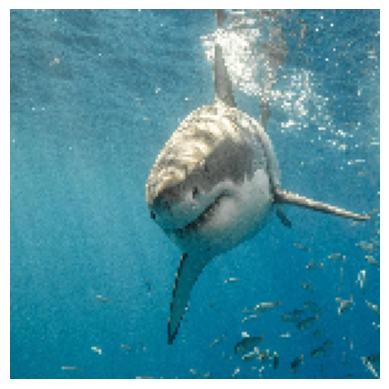

1/1 [==============================] - 0s 58ms/step
The image is classified as a sea animal.


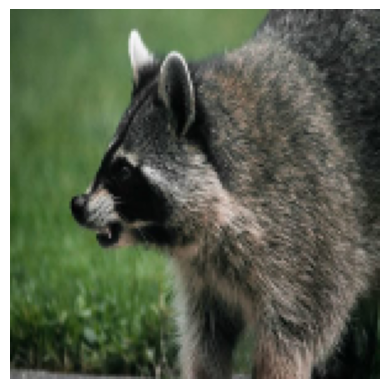

1/1 [==============================] - 0s 31ms/step
The image is classified as a sea animal.


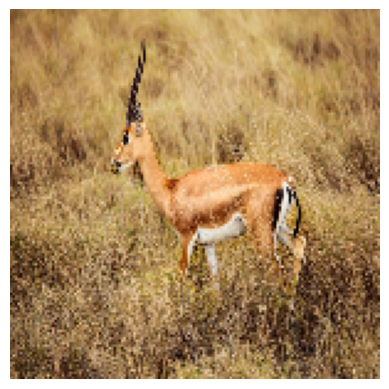

1/1 [==============================] - 0s 45ms/step
The image is classified as a land animal.
Error processing image: .DS_Store
OpenCV(4.7.0) /Users/runner/work/opencv-python/opencv-python/opencv/modules/imgproc/src/resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'resize'



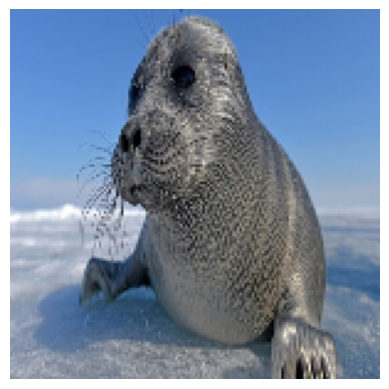

1/1 [==============================] - 0s 39ms/step
The image is classified as a sea animal.


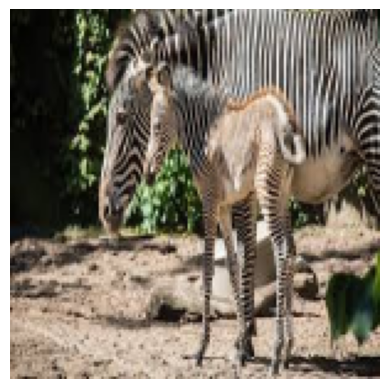

1/1 [==============================] - 0s 45ms/step
The image is classified as a land animal.


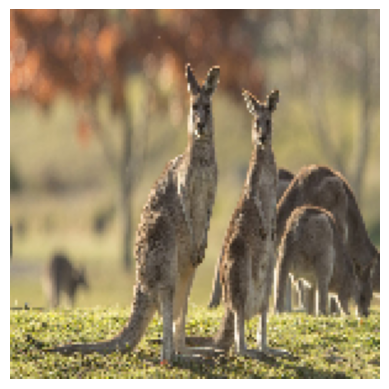

1/1 [==============================] - 0s 38ms/step
The image is classified as a land animal.


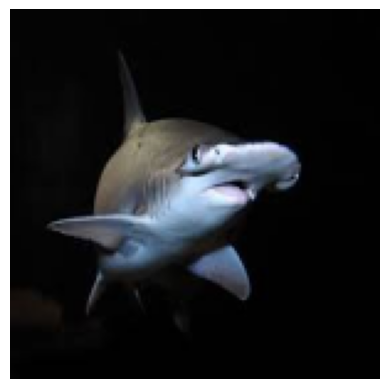

1/1 [==============================] - 0s 94ms/step
The image is classified as a sea animal.


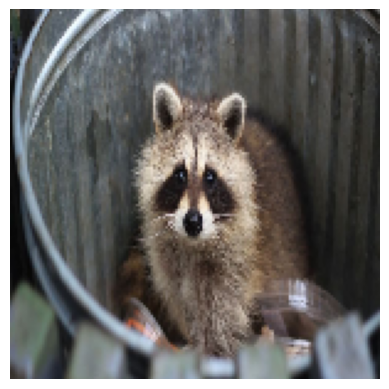

1/1 [==============================] - 0s 40ms/step
The image is classified as a sea animal.


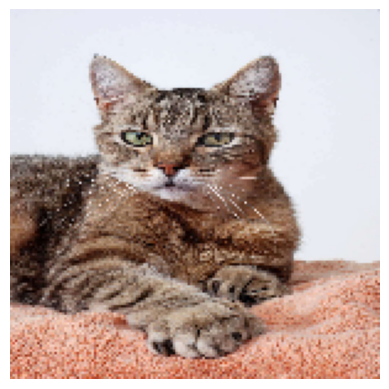

1/1 [==============================] - 0s 42ms/step
The image is classified as a land animal.


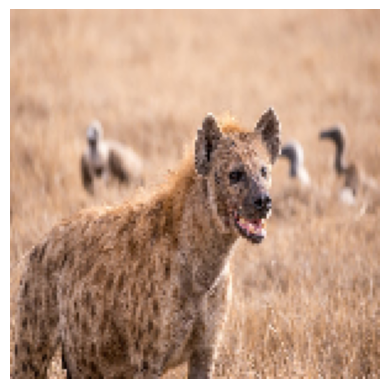

1/1 [==============================] - 0s 43ms/step
The image is classified as a sea animal.


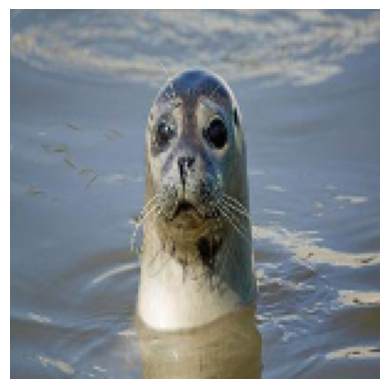

1/1 [==============================] - 0s 54ms/step
The image is classified as a land animal.


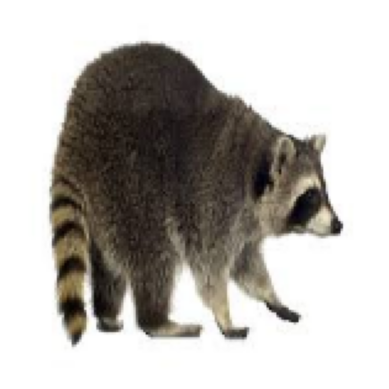

1/1 [==============================] - 0s 50ms/step
The image is classified as a land animal.


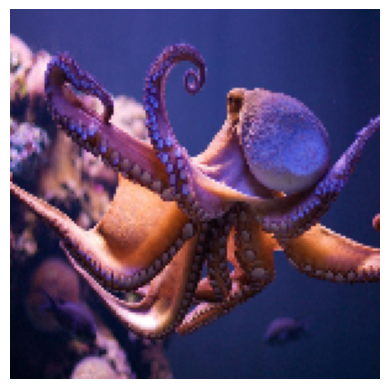

1/1 [==============================] - 0s 39ms/step
The image is classified as a sea animal.


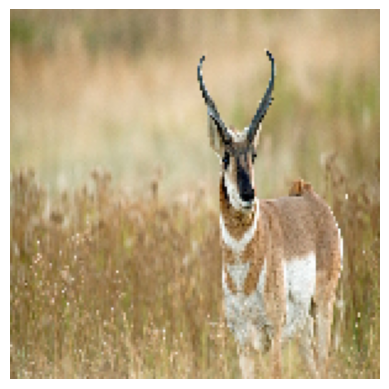

1/1 [==============================] - 0s 50ms/step
The image is classified as a land animal.


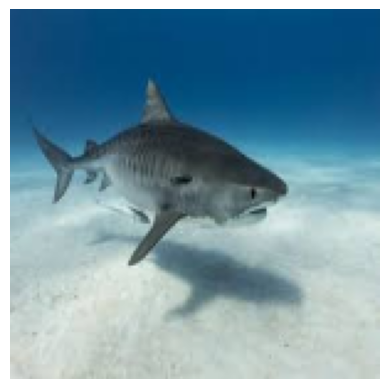

1/1 [==============================] - 0s 40ms/step
The image is classified as a sea animal.


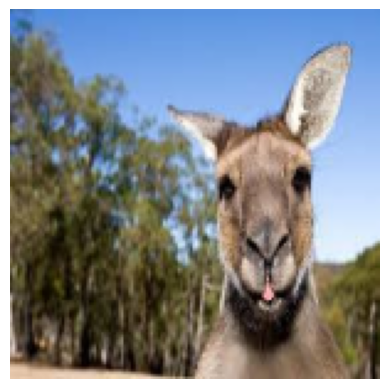

1/1 [==============================] - 0s 40ms/step
The image is classified as a land animal.


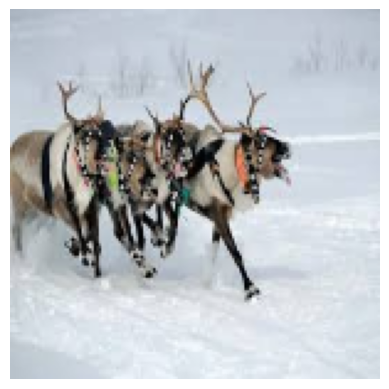

1/1 [==============================] - 0s 34ms/step
The image is classified as a land animal.


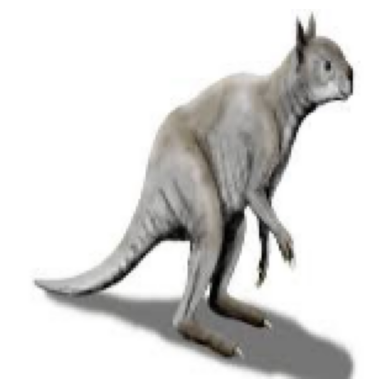

1/1 [==============================] - 0s 49ms/step
The image is classified as a land animal.


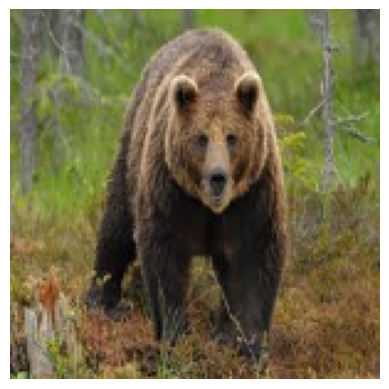

1/1 [==============================] - 0s 36ms/step
The image is classified as a land animal.


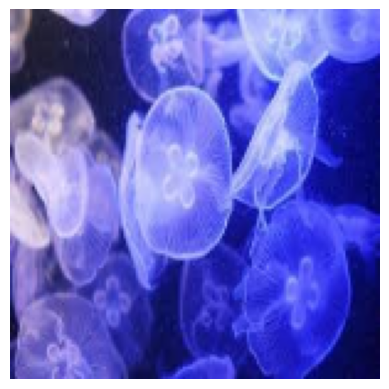

1/1 [==============================] - 0s 46ms/step
The image is classified as a sea animal.


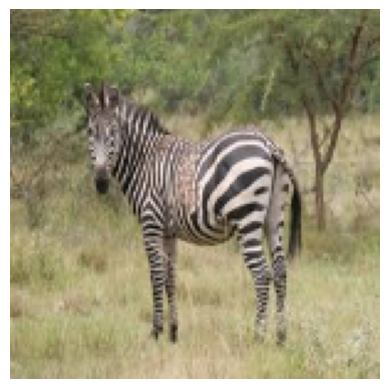

1/1 [==============================] - 0s 57ms/step
The image is classified as a sea animal.


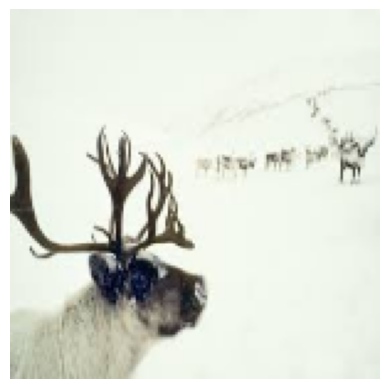

1/1 [==============================] - 0s 54ms/step
The image is classified as a land animal.


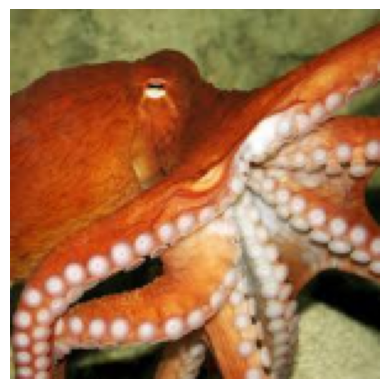

1/1 [==============================] - 0s 48ms/step
The image is classified as a sea animal.


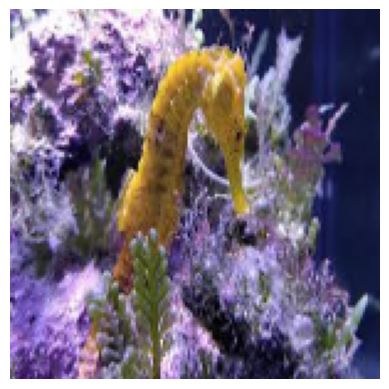

1/1 [==============================] - 0s 33ms/step
The image is classified as a sea animal.


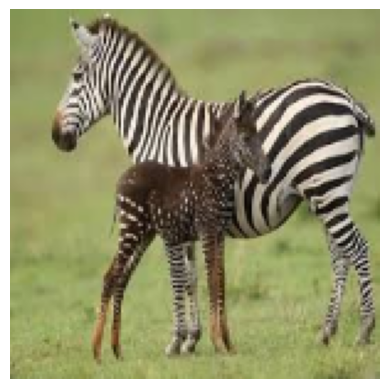

1/1 [==============================] - 0s 31ms/step
The image is classified as a land animal.


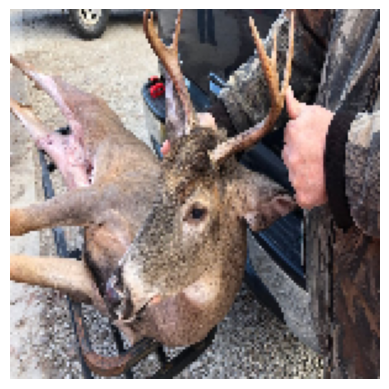

1/1 [==============================] - 0s 44ms/step
The image is classified as a land animal.


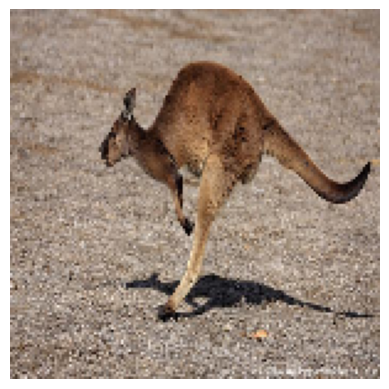

1/1 [==============================] - 0s 37ms/step
The image is classified as a land animal.


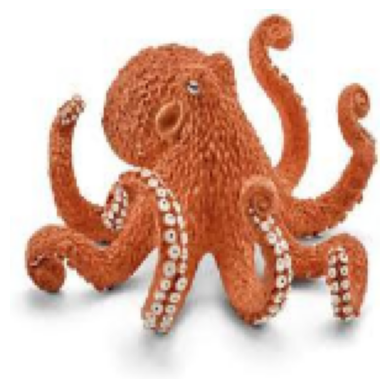

1/1 [==============================] - 0s 36ms/step
The image is classified as a sea animal.


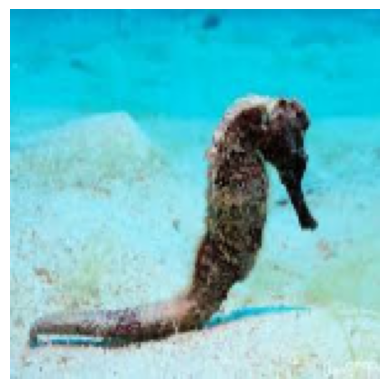

1/1 [==============================] - 0s 34ms/step
The image is classified as a sea animal.


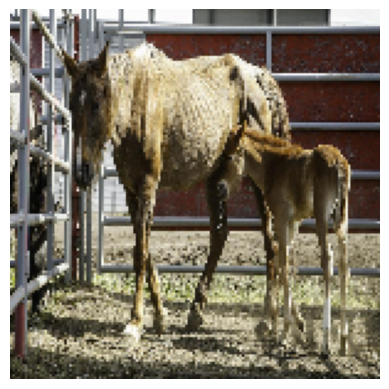

1/1 [==============================] - 0s 37ms/step
The image is classified as a land animal.


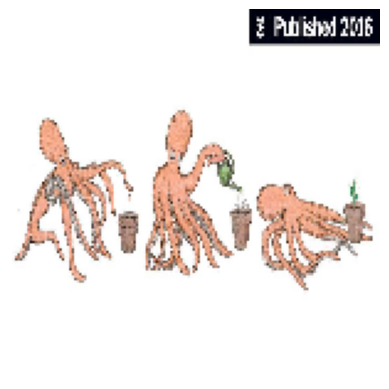

1/1 [==============================] - 0s 35ms/step
The image is classified as a sea animal.


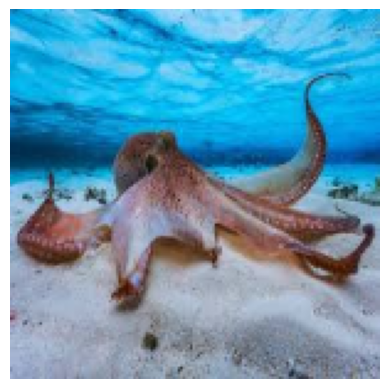

1/1 [==============================] - 0s 32ms/step
The image is classified as a sea animal.


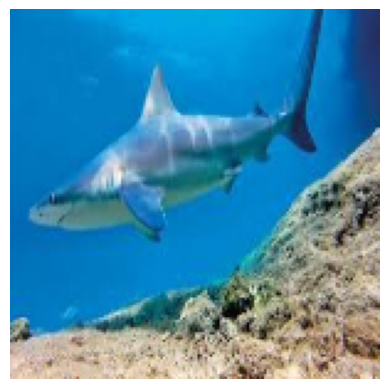

1/1 [==============================] - 0s 38ms/step
The image is classified as a sea animal.


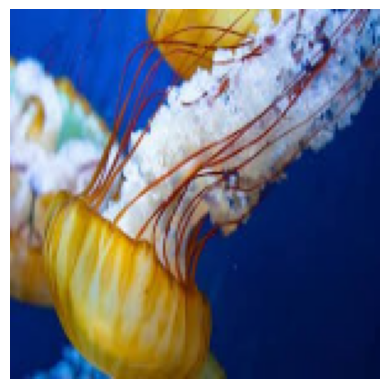

1/1 [==============================] - 0s 35ms/step
The image is classified as a sea animal.


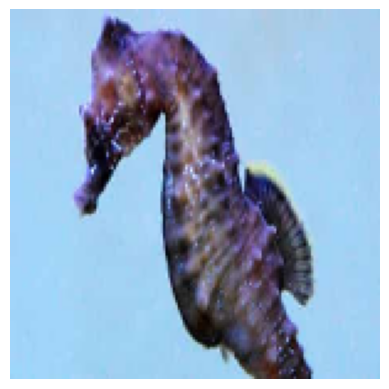

1/1 [==============================] - 0s 36ms/step
The image is classified as a land animal.


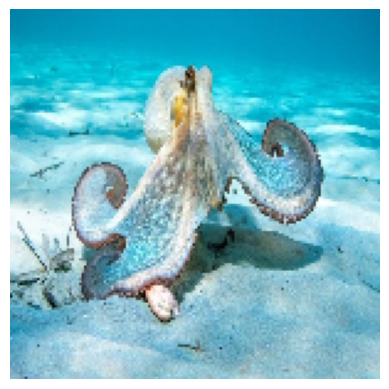

1/1 [==============================] - 0s 32ms/step
The image is classified as a sea animal.


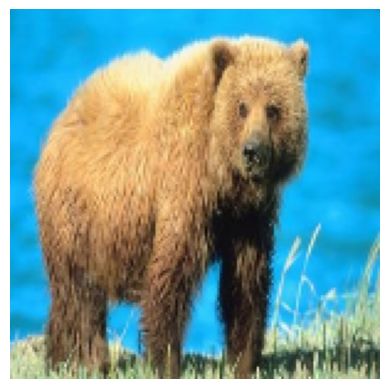

1/1 [==============================] - 0s 37ms/step
The image is classified as a sea animal.


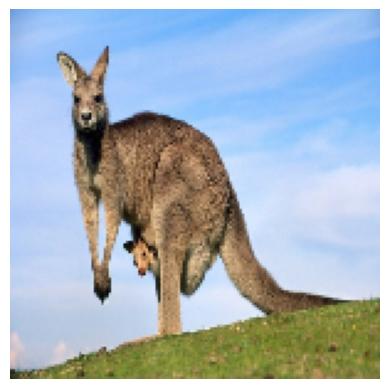

1/1 [==============================] - 0s 35ms/step
The image is classified as a land animal.


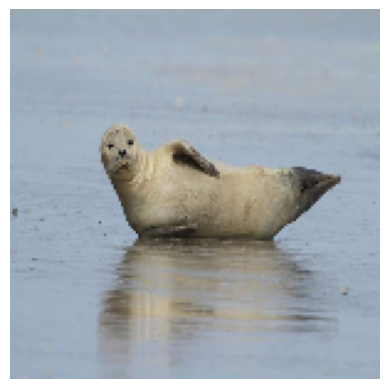

1/1 [==============================] - 0s 39ms/step
The image is classified as a sea animal.


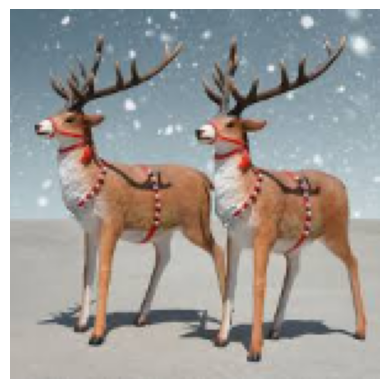

1/1 [==============================] - 0s 37ms/step
The image is classified as a land animal.


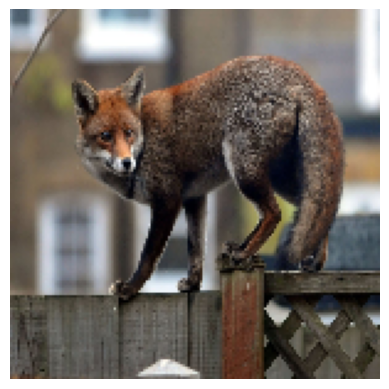

1/1 [==============================] - 0s 35ms/step
The image is classified as a land animal.


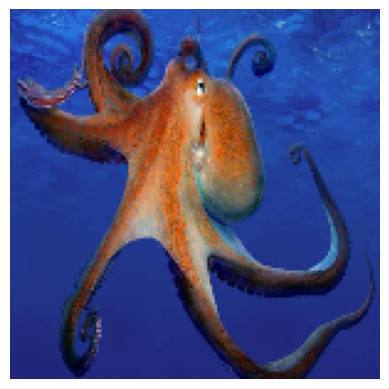

1/1 [==============================] - 0s 36ms/step
The image is classified as a sea animal.


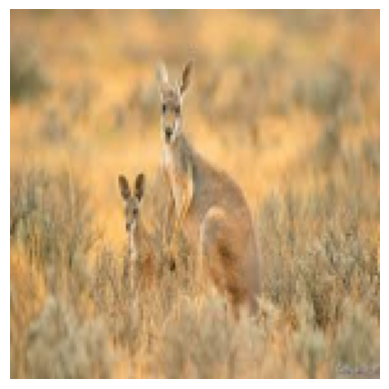

1/1 [==============================] - 0s 41ms/step
The image is classified as a sea animal.


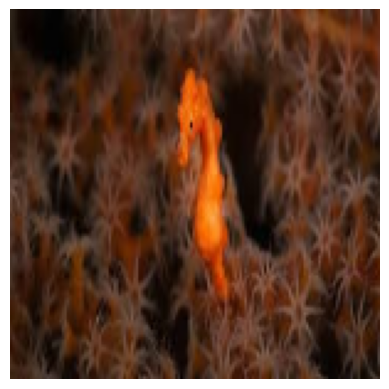

1/1 [==============================] - 0s 33ms/step
The image is classified as a sea animal.


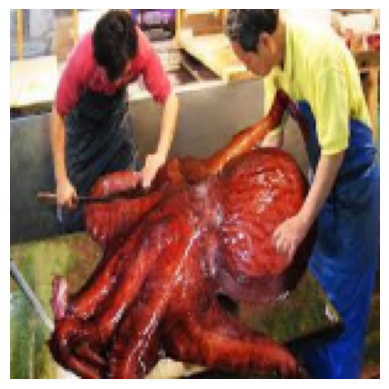

1/1 [==============================] - 0s 31ms/step
The image is classified as a sea animal.


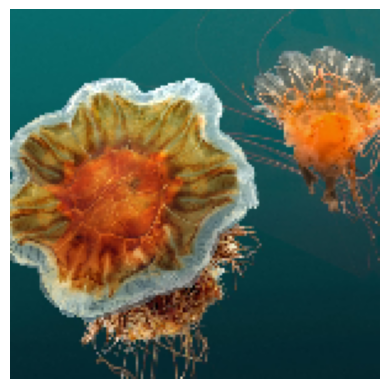

1/1 [==============================] - 0s 39ms/step
The image is classified as a sea animal.


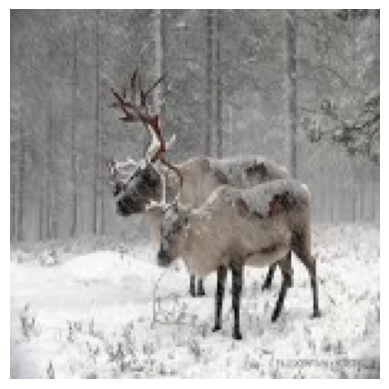

1/1 [==============================] - 0s 36ms/step
The image is classified as a land animal.


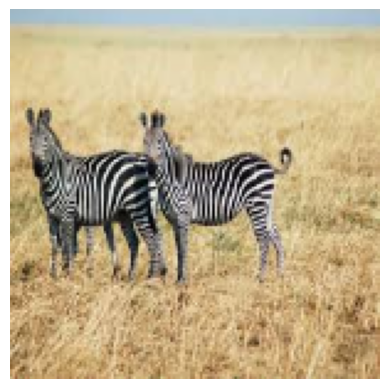

1/1 [==============================] - 0s 44ms/step
The image is classified as a land animal.


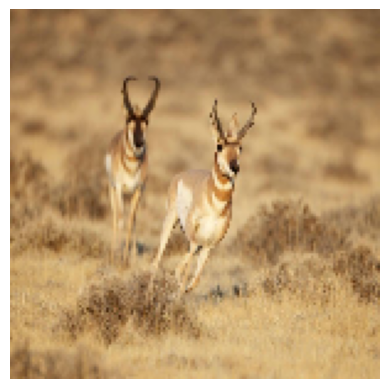

1/1 [==============================] - 0s 36ms/step
The image is classified as a land animal.


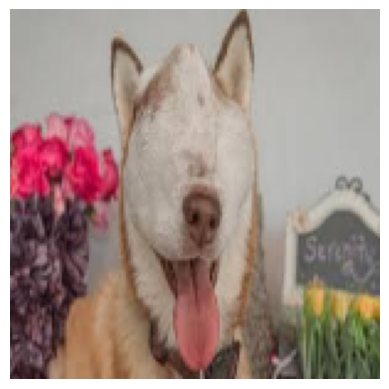

1/1 [==============================] - 0s 40ms/step
The image is classified as a land animal.


In [40]:
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model

# Define the image dimensions
img_width, img_height = 150, 150

# Load the trained model
model = load_model('/Users/raphaelsackey/Desktop/animal dataset/model1.h5')

# Define the paths to the new_land_animals folder
new_land_animals_path = '/Users/raphaelsackey/Desktop/animal dataset/new_land_animal'

# Iterate through the images in the new_land_animals folder
for filename in os.listdir(new_land_animals_path):
    try:
        image_path = os.path.join(new_land_animals_path, filename)

        # Load and resize the image
        img = cv2.imread(image_path)
        img = cv2.resize(img, (img_width, img_height))

        # Display the image
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()

        # Preprocess the image for prediction
        img = img / 255.0
        img = np.expand_dims(img, axis=0)

        # Make predictions
        prediction = model.predict(img)
        if prediction[0][0] < 0.5:
            print("The image is classified as a sea animal.")
        else:
            print("The image is classified as a land animal.")
            
    except Exception as e:
        print(f"Error processing image: {filename}\n{str(e)}")


you can see that even though i used the same testing code and dataset my model was able to accurately tell
which pictures were land and see  

in conclusion, dont trust chatgpt. it is better to use it as a debuger.